ÜSKÜDAR ÜNİVERSİTESİ - YÜKSEK LİSANS YAPAYAY ZEKA MÜHENDİSLİĞİ (TEZLİ)

Ders: Sayısal Görüntü İşleme

Ödev: Final

Öğrenci: Mehmet Ortacebin


# 1.	Kütüphanelerin İçe Aktarılması
o	Veri işleme için pandas, sayısal işlemler için numpy, opencv ve skimage görselleştirme için matplotlib ve seaborn kütüphanelerini içe aktarın.
o	Ayrıca os modülünü kullanarak dosya yolunu belirtin.


In [ ]:
from google.colab import drive
import pandas as pd
import numpy as np
import os
import cv2
import matplotlib.pyplot as plt
import seaborn as sns
from skimage import io

In [ ]:
# Google Drive'ı bağlama
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
data_path = '/content/drive/MyDrive/ColabNotebooks/SayisalGoruntuIsleme/Final/test'

pneumonia_path = os.path.join(data_path, 'PNEUMONIA')
normal_path = os.path.join(data_path, 'NORMAL')

pneumonia_images = [os.path.join(pneumonia_path, img) for img in os.listdir(pneumonia_path) if img.endswith('.jpeg')]
normal_images = [os.path.join(normal_path, img) for img in os.listdir(normal_path) if img.endswith('.jpeg')]

# Toplam görüntü sayısı
print(f"PNEUMONIA Klasöründeki Görüntü Sayısı: {len(pneumonia_images)}")
print(f"NORMAL Klasöründeki Görüntü Sayısı: {len(normal_images)}")


PNEUMONIA Klasöründeki Görüntü Sayısı: 390
NORMAL Klasöründeki Görüntü Sayısı: 234


# 2. Görüntü Yükleme ve Görselleştirme
1.	Rastgele Görüntüler Seçme
o	train_df içindeki "Image" sütunundan rastgele 9 görüntü seçin.
o	Bu görüntüleri yan yana görselleştirerek veri setindeki örnek görüntüleri inceleyin.
________________________________________


In [ ]:
import random

random.seed(42)

sampled_images = random.sample(pneumonia_images, 4) + random.sample(normal_images, 5)
random.shuffle(sampled_images)

print("Seçilen Görüntüler:")
for img_path in sampled_images:
    print(img_path)


Seçilen Görüntüler:
/content/drive/MyDrive/ColabNotebooks/SayisalGoruntuIsleme/Final/test/NORMAL/NORMAL-2403676-0001.jpeg
/content/drive/MyDrive/ColabNotebooks/SayisalGoruntuIsleme/Final/test/PNEUMONIA/BACTERIA-4269599-0006.jpeg
/content/drive/MyDrive/ColabNotebooks/SayisalGoruntuIsleme/Final/test/NORMAL/NORMAL-3437568-0001.jpeg
/content/drive/MyDrive/ColabNotebooks/SayisalGoruntuIsleme/Final/test/NORMAL/NORMAL-3065672-0001.jpeg
/content/drive/MyDrive/ColabNotebooks/SayisalGoruntuIsleme/Final/test/PNEUMONIA/BACTERIA-9060950-0001.jpeg
/content/drive/MyDrive/ColabNotebooks/SayisalGoruntuIsleme/Final/test/PNEUMONIA/VIRUS-9325276-0001.jpeg
/content/drive/MyDrive/ColabNotebooks/SayisalGoruntuIsleme/Final/test/NORMAL/NORMAL-2850034-0001.jpeg
/content/drive/MyDrive/ColabNotebooks/SayisalGoruntuIsleme/Final/test/NORMAL/NORMAL-786023-0001.jpeg
/content/drive/MyDrive/ColabNotebooks/SayisalGoruntuIsleme/Final/test/PNEUMONIA/BACTERIA-1714895-0001.jpeg


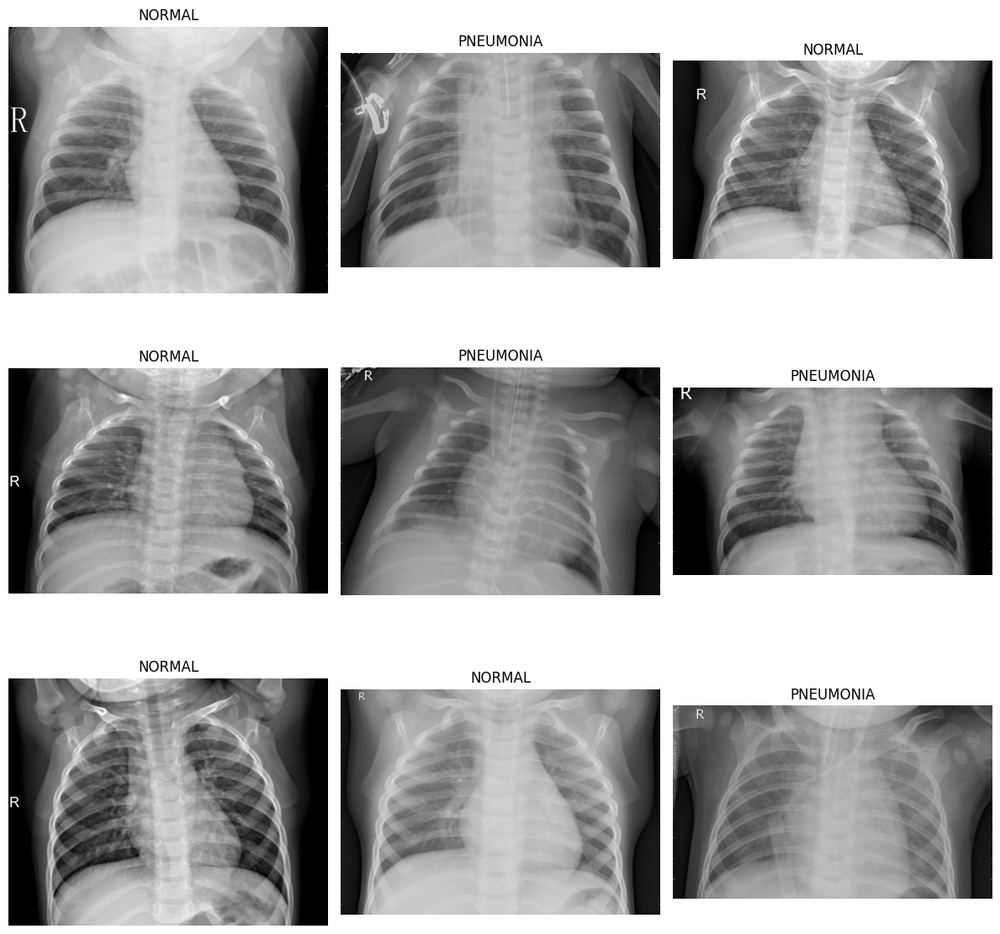

In [ ]:
# Görselleştirme
fig, axes = plt.subplots(3, 3, figsize=(12, 12))

for i, ax in enumerate(axes.flatten()):
    img_path = sampled_images[i]
    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
    category = "PNEUMONIA" if "PNEUMONIA" in img_path else "NORMAL"

    # Görseli ekrana çiz
    ax.imshow(img, cmap='gray')
    ax.set_title(category, fontsize=12)
    ax.axis("off")

plt.tight_layout()
plt.show()


# 3. Görüntü İşleme ve İyileştirme (Pre-processing)
1.	Görüntüleri Akciğer bölgeleri kaybolmayacak şekilde kenarlardan kırpın (Crop),(ilgi alanı dışındaki gürültü bölgelerinden kurtulun
o	Orijinal ve Crop edilmiş görüntüleri görseleştirin.
2.	Arasınav ödevi çıktılarını inceleyerek Kontrast Germe (Stretching) Histogram Eşitleme (Equalization) yöntemlerinden uygun gördüğünüzü crop edilmiş görüntüye uygulayın. (YORUM)
o	Crop edilmişve dönüşüme uğramış  görüntüleri görseleştirin.

3.	Bir önceki adımın çıktısına gürültü azaltma işlemlerinden birini seçerek uygulayın (örn: Median ve Gaussian Blur).
o	Görüntüleri görseleştirin


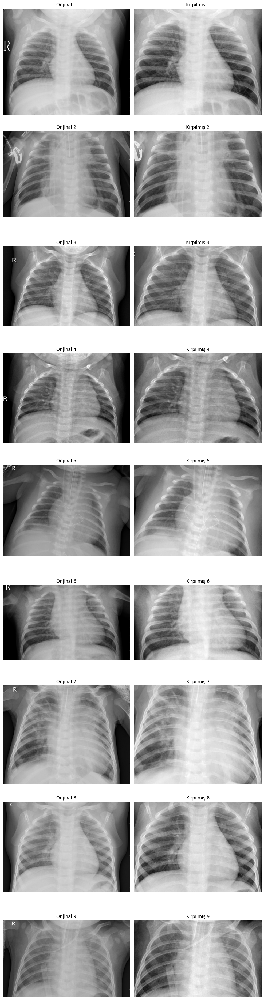

In [ ]:
import cv2
import random
import matplotlib.pyplot as plt

def crop_image(image):
    """
    Görüntüyü kenarlardan %10 kırpar.
    """
    height, width = image.shape
    return image[int(height * 0.1):int(height * 0.9), int(width * 0.1):int(width * 0.9)]

# Rastgele 9 görüntü seçme
random.seed(42)
sample_images = random.sample(pneumonia_images, 5) + random.sample(normal_images, 4)
random.shuffle(sample_images)

# Görüntüleri yükleyip kırpma işlemi
original_cropped_pairs = [(cv2.imread(img_path, cv2.IMREAD_GRAYSCALE), crop_image(cv2.imread(img_path, cv2.IMREAD_GRAYSCALE))) for img_path in sample_images]

# Görselleştirme
fig, axes = plt.subplots(9, 2, figsize=(10, 38))

for i, (orig, cropped) in enumerate(original_cropped_pairs):
    axes[i, 0].imshow(orig, cmap='gray')
    axes[i, 0].set_title(f"Orijinal {i+1}")
    axes[i, 0].axis("off")

    axes[i, 1].imshow(cropped, cmap='gray')
    axes[i, 1].set_title(f"Kırpılmış {i+1}")
    axes[i, 1].axis("off")

plt.tight_layout()
plt.show()



Görüntü işleme ve iyileştirme (pre-processing) aşamasında yapılan kırpma işlemi, genellikle görüntüdeki gereksiz bölgeleri kaldırarak, sadece ilgilenilen alanı daha belirgin hale getirmeyi amaçlar. Özellikle tıbbi görüntülerde, örneğin akciğer röntgenlerinde, kenar kısımlarında hasta bilgileri, tarayıcı işaretleri veya boş alanlar olabilir. Bu tür gereksiz bölümler, modelin doğru şekilde öğrenmesini zorlaştırabilir. Kırpma işlemi ile sadece akciğer bölgesi odaklanarak, modelin daha verimli ve doğru şekilde çalışması sağlanır. Ayrıca, görüntüdeki gereksiz kısımların kaldırılması, hesaplama yükünü azaltır ve işlem süresini kısaltır. Görüntüdeki ilgisiz bölgeler çıkarıldığında, model yalnızca önemli verilere odaklanır. Kenarlardan kırpma işlemi, verilerin tutarlılığını artırarak, özellikle farklı kaynaklardan gelen görüntülerdeki veri tutarsızlıklarını azaltır. Bu işlem, tıbbi görüntü analizi, nesne tanıma ve derin öğrenme gibi uygulamalarda kritik bir adımdır.

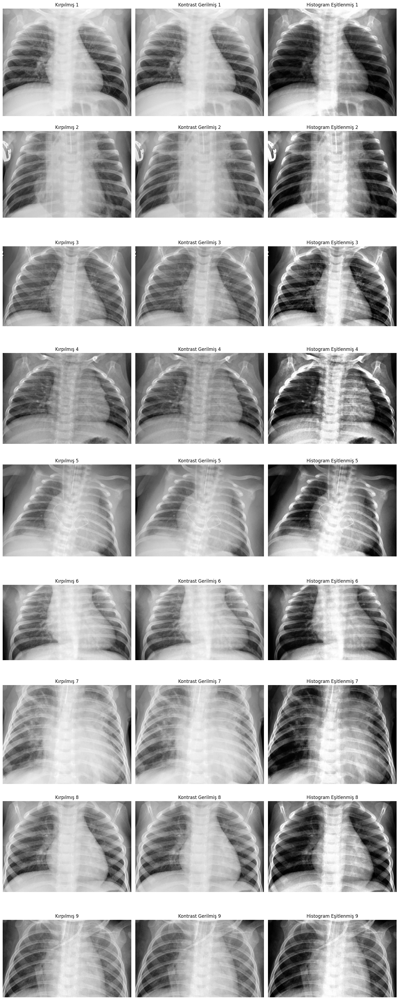

In [ ]:
# Kontrast Germe (Stretching)
def contrast_stretching(image):
    min_val, max_val = image.min(), image.max()
    stretched = ((image - min_val) / (max_val - min_val) * 255).astype('uint8')
    return stretched

# Histogram Eşitleme (Equalization)
def histogram_equalization(image):
    return cv2.equalizeHist(image)

# Kontrast Germe ve Histogram Eşitleme uygulanmış görüntüleri oluştur
processed_images = [(cropped, contrast_stretching(cropped), histogram_equalization(cropped)) for _, cropped in original_cropped_pairs]

# Görselleştirme
fig, axes = plt.subplots(9, 3, figsize=(15, 38))  # 9 satır, 3 sütun (Kırpılmış, Kontrast Germe, Histogram Eşitleme)

for i, (cropped, stretched, equalized) in enumerate(processed_images):
    axes[i, 0].imshow(cropped, cmap='gray')
    axes[i, 0].set_title(f"Kırpılmış {i+1}")
    axes[i, 0].axis("off")

    axes[i, 1].imshow(stretched, cmap='gray')
    axes[i, 1].set_title(f"Kontrast Gerilmiş {i+1}")
    axes[i, 1].axis("off")

    axes[i, 2].imshow(equalized, cmap='gray')
    axes[i, 2].set_title(f"Histogram Eşitlenmiş {i+1}")
    axes[i, 2].axis("off")

plt.tight_layout()
plt.show()


# Kontrast Gerilmiş vs. Histogram Eşitlenmiş:
Kontrast Germe (Stretching), minimum ve maksimum piksel değerlerini genişleterek görüntünün kontrastını artırıyor. Bu işlem genellikle mevcut kontrast aralığını tam olarak kullanmayan görüntüler için faydalıdır. Ancak, histogram eşitleme kadar etkili bir şekilde lokal kontrastı artırmaz.

Histogram Eşitleme (Equalization), görüntünün piksel yoğunluk dağılımını dengeleyerek hem parlak hem de koyu alanlarda detayların daha belirgin hale gelmesini sağlıyor. Bu özellikle düşük kontrastlı tıbbi görüntülerde önemli olabilir.

# Gözle Görülebilir Farklar:
Histogram eşitleme ile işlenen görüntüler, genel olarak daha fazla detay içeriyor. Kemik yapıları, damarlar ve doku detayları daha net hale gelmiş.

Kontrast germe işlemi, parlaklık seviyelerini genişletse de, bazı bölgelerde detay kaybına neden olmuş olabilir. Özellikle çok parlak veya çok koyu alanlarda histogram eşitleme daha iyi sonuçlar vermiş gibi görünüyor.

**Histogram eşitleme**, düşük kontrastlı alanlardaki farkları daha belirgin hale getirerek görüntünün genel kalitesini arttırmaktadır.

Bir sonraki adımda Histogram Eşitleme ile devam etme kararı aldım. Bu yöntemin X-ray görüntülerinde daha fazla detay ortaya çıkarması ve kontrastı daha dengeli şekilde iyileştirmektedir.

Kontrast germe işlemi parlaklık aralığını genişletse de, histogram eşitleme tüm görüntüde kontrastı optimize ederek kemik, doku ve damar detaylarını daha belirgin hale getirdi. Ayrıca, düşük kontrastlı bölgelerde detay kaybını önleyerek tıbbi analiz için daha uygun bir sonuç sundu. Bu nedenle, daha net ve dengeli görüntüler elde etmek için Histogram Eşitleme yöntemiyle devam edilecektir.

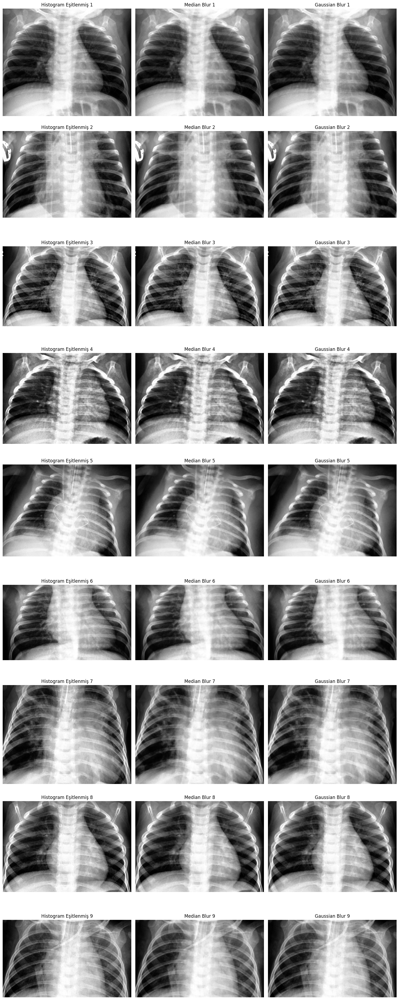

In [ ]:
# Median Blur
def median_blur(image, kernel_size=5):
    return cv2.medianBlur(image, kernel_size)

# Gaussian Blur
def gaussian_blur(image, kernel_size=5):
    return cv2.GaussianBlur(image, (kernel_size, kernel_size), 0)

# Gürültü azaltma işlemleri
filtered_images = [(equalized, median_blur(equalized), gaussian_blur(equalized)) for _, _, equalized in processed_images]

# Görselleştirme
fig, axes = plt.subplots(9, 3, figsize=(15, 38))
for i, (equalized, median_filtered, gaussian_filtered) in enumerate(filtered_images):
    axes[i, 0].imshow(equalized, cmap='gray')
    axes[i, 0].set_title(f"Histogram Eşitlenmiş {i+1}")
    axes[i, 0].axis("off")

    axes[i, 1].imshow(median_filtered, cmap='gray')
    axes[i, 1].set_title(f"Median Blur {i+1}")
    axes[i, 1].axis("off")

    axes[i, 2].imshow(gaussian_filtered, cmap='gray')
    axes[i, 2].set_title(f"Gaussian Blur {i+1}")
    axes[i, 2].axis("off")

plt.tight_layout()
plt.show()


Görüntülere bakıldığında Median Blur, Gaussian Blur ile karşılaştırıldığında daha keskin hatlar koruyarak gürültüyü azalttığı görülüyor. Gaussian Blur ise daha fazla bulanıklık ekleyerek bazı detayları kaybettirmiş olabilir.

# Karşılaştırma:
**Median Blur:** Gürültüyü azaltırken kenar detaylarını daha iyi koruyor. Özellikle X-ray görüntüleri gibi kenarların önemli olduğu tıbbi görüntülerde tercih edilmesi daha mantıklı.

**Gaussian Blur:** Daha yumuşak geçişler sağlasa da, bazı kemik yapılarında ve kritik detaylarda bulanıklığa neden olabiliyor.

Bu nedenle, detay kaybını önlemek ve tıbbi analiz açısından daha iyi sonuç almak için Median Blur yöntemiyle devam etmek daha doğru bir yaklaşım olacaktır.

# 4.	Eşik sayısı belirleme

o	Tek eşik değeri kullanacaksanız, Görüntülere Gauss yoğunluk dönüşümü gibi akciğer yoğunluk değerleri ile düşük ve yüksek değerleri ayıracak bir transform uygulayınız.

 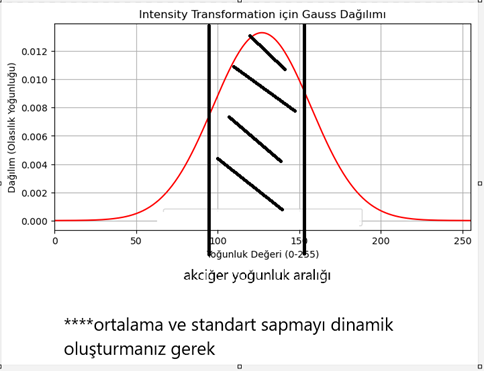

o	Dönüşüm uygulanmayacaksa optimum eşik sayısı belirlenmeli bunu dikkate alın. (örnek1: eşik sayısı 2 bölge sayısı 3 (alt-orta-üst)  orta=1, else=0, örnek2:esik sayısı 5, bölge sayısı 6 (a1-a2-o1-o2-u1-u2) o1&o2=1, else=0)


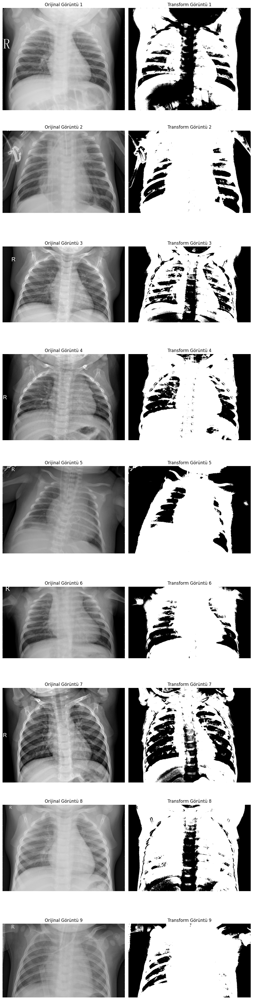

In [ ]:
# Sabit eşik değerleri
thresholds = [0, 50, 100, 150, 200, 255]

def threshold_segmentation(image, thresholds):
    segmented_image = np.zeros_like(image, dtype=np.uint8)

    # Bölgelere ayırma işlemi
    for i in range(1, len(thresholds) - 1):
        lower = thresholds[i]
        upper = thresholds[i + 1]

        if i == 2 or i == 3:  # o1 ve o2 bölgeleri için
            segmented_image[(image >= lower) & (image < upper)] = 1
        else:
            segmented_image[(image >= lower) & (image < upper)] = 0

    return segmented_image

# 9 farklı görseli işleme
fig, axes = plt.subplots(9, 2, figsize=(10, 40))

for idx, image_path in enumerate(sampled_images[:9]):
    original_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    transformed_image = threshold_segmentation(original_image, thresholds)

    # Görselleştirme
    axes[idx, 0].imshow(original_image, cmap='gray')
    axes[idx, 0].set_title(f'Orijinal Görüntü {idx+1}')
    axes[idx, 0].axis('off')

    axes[idx, 1].imshow(transformed_image, cmap='gray')
    axes[idx, 1].set_title(f'Transform Görüntü {idx+1}')
    axes[idx, 1].axis('off')

plt.tight_layout()
plt.show()

Transform görüntülerinde uygulanan eşikleme işlemi, kemik yapılarını belirginleştirmiş ve kaburgalar ile omurgayı net bir şekilde ayrıştırmıştır. Bu durum, medikal analizler için faydalı olabilir. Ancak bazı görüntülerde arka planda istenmeyen siyah ve beyaz alanlar bulunmakta, bu da eşik değerlerinin optimize edilmesi gerektiğini göstermektedir. Özellikle Görüntü 2 ve 6’da daha fazla beyaz alan görülmesi, düşük yoğunluklu bölgelerin yanlış eşiklenmiş olabileceğini düşündürmektedir. Ayrıca, akciğer dokularında bazı anatomik detayların kaybolduğu fark ediliyor. Bu nedenle, daha iyi bir segmentasyon için adaptif eşikleme veya Otsu yöntemi gibi dinamik yaklaşımlar denenebilir.

# 4. Thresholding
1.	Global Thresholding, Otsu veya skimage all filter kütüphanesini kullanarak (from skimage.filters import try_all_threshold) https://scikit-image.org/docs/dev/auto_examples/segmentation/plot_thresholding.html en az 2 thresholding yöntemi  ile eşik değerlerini belirleyiniz.
2.	Eşik değerlerini görüntülere uygulayarak binary görüntüleri görselleştirip uygun thresholding yöntemini i seçiniz. (YORUM)


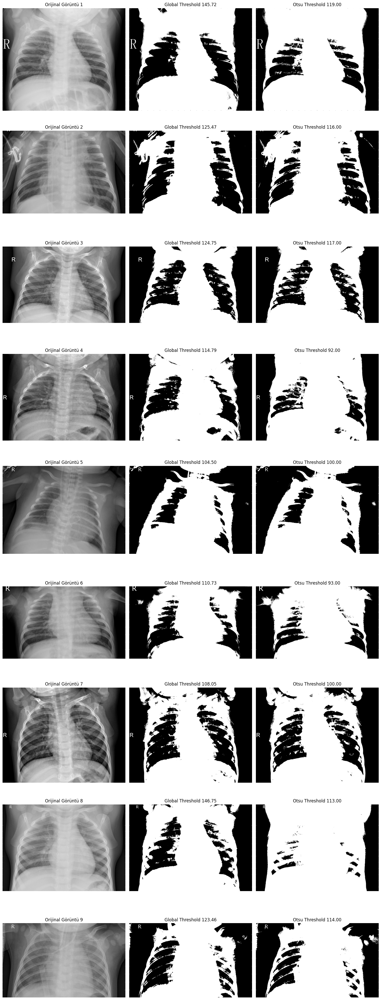

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from skimage.filters import threshold_otsu, threshold_mean


fig, axes = plt.subplots(9, 3, figsize=(15, 40))

for idx, image_path in enumerate(sampled_images[:9]):
    original_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Global Thresholding
    global_thresh = threshold_mean(original_image)
    binary_global = original_image > global_thresh

    # Otsu thresholding
    otsu_thresh = threshold_otsu(original_image)
    binary_otsu = original_image > otsu_thresh

    # Görselleştirme
    axes[idx, 0].imshow(original_image, cmap='gray')
    axes[idx, 0].set_title(f'Orijinal Görüntü {idx+1}')
    axes[idx, 0].axis('off')

    axes[idx, 1].imshow(binary_global, cmap='gray')
    axes[idx, 1].set_title(f'Global Threshold {global_thresh:.2f}')
    axes[idx, 1].axis('off')

    axes[idx, 2].imshow(binary_otsu, cmap='gray')
    axes[idx, 2].set_title(f'Otsu Threshold {otsu_thresh:.2f}')
    axes[idx, 2].axis('off')

plt.tight_layout()
plt.show()

Global Thresholding yönteminde belirlenen eşik değeri sabit olduğu için bazı bölgelerde fazla beyazlık (over-segmentation) veya gereğinden fazla karanlık bölgeler (under-segmentation) oluşmuş. Özellikle aydınlık seviyesinin değişken olduğu X-ray görüntülerinde global thresholding, doku detaylarını kaybedebilir.

Otsu Thresholding, görüntüdeki histogramı analiz ederek optimal bir eşik değeri belirlediği için daha adaptif bir segmentasyon sağlıyor. Çoğu görüntüde Otsu yöntemi daha düşük eşik değerleri belirleyerek ince detayları daha iyi ayırmış gibi görünüyor.

Otsu thresholding, görüntü histogramını analiz ederek en iyi eşik değerini belirler ve farklı ışık koşullarına daha iyi uyum sağlar. Buna karşın, global thresholding sabit bir eşik değeri kullanır ve farklı aydınlatma seviyelerine sahip bölgelerde yanlış segmentasyon yapabilir. Özellikle X-ray gibi tıbbi görüntülerde, ince yapıları korumak ve önemli detayları kaybetmemek için Otsu thresholding daha güvenilir bir yöntemdir. Bundan dolayı Otsu thresholding ile devam edilecektir.

# 3. Post-processing
1.	Uygun morfolojik operatörleri, uygun structural element yapısı ve boyutunu seçerek görüntüye uygulayınız. (YORUM)
o	Giriş ve Çıkış Görüntülerini görseleştirin
.
2.	Görüntüye bağlantı bileşen analizi (connected component labeling-CCL) (cv2.connectedComponents) uygulayarak olası bölge sayısını print CCL çıktısını plot edin.

3.	Elde ettiğiniz labellar için, Centroid ve Area bilgilerinin kesinlikle olacağı, ayrıca bölgelerin yoğunluk ve şekilsel özelliklerini belirten en az 5 tane özniteliği print edin.
o	(cv2.connectedComponentsWithStats önerebilirim ama scikit-image’ın regionprops u daha iyi)
4.	Elde ettiğiniz stats ve labelsları inceleyerek akciğer alanlarını en iyi ifade eden öznitelikleri yorumlayınız.
o	Belirlediğniz özniteliklere göre filtreleme yapın. (örn: maks alana sahip ilk iki bölge, if maks alana sahip iki bölge and bölgelerin centroidleri ortada; filter; else try 3. Bölge; return)
o	Belirleyici öznitelik bulunamadıysa. Her görüntüde otomatik olarak label belirleyen algoritmayı yazın

5.	Seçtiğiniz labela sahip filtrelenmiş görüntülere uygun morfolojik işlemleri (structural elemant tipi ve boyutu belirleyerek) uygulayın. Giriş ve çıkış görüntülerini görselleştirin.



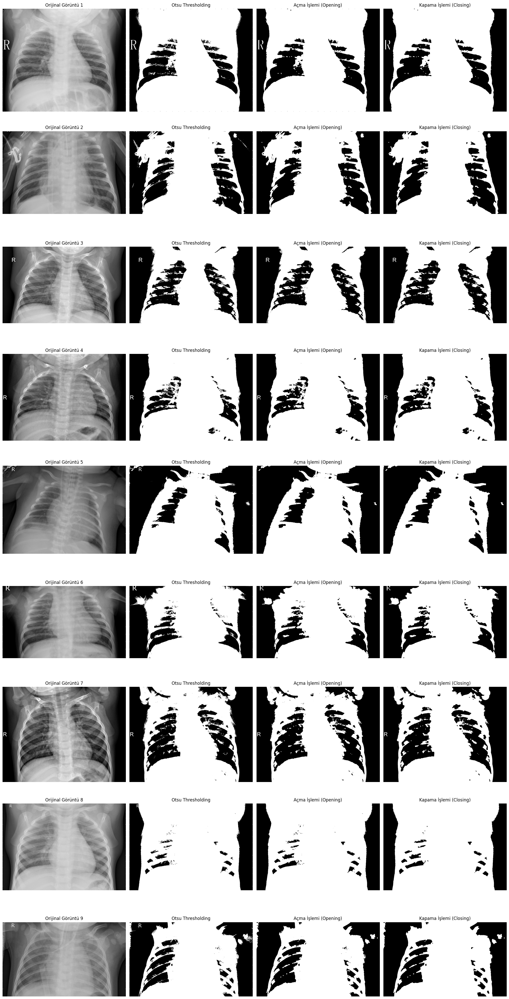

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from skimage.filters import threshold_otsu

# Görseli işleyip morfolojik işlemleri uygulamak
def apply_morphological_operations(image_path):
    original_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Otsu Thresholding
    otsu_thresh = threshold_otsu(original_image)
    binary_otsu = original_image > otsu_thresh

    # Morfolojik Operatörler
    kernel = np.ones((5, 5), np.uint8)  # 5x5 boyutunda bir kernel
    morph_open = cv2.morphologyEx(binary_otsu.astype(np.uint8), cv2.MORPH_OPEN, kernel)
    morph_close = cv2.morphologyEx(morph_open, cv2.MORPH_CLOSE, kernel)

    # Görselleştirme
    return original_image, binary_otsu, morph_open, morph_close

# 9 Görsel için işlem yapalım
fig, axes = plt.subplots(9, 4, figsize=(20, 40))

for idx, image_path in enumerate(sampled_images[:9]):
    original_image, binary_otsu, morph_open, morph_close = apply_morphological_operations(image_path)

    # Görselleştirme
    axes[idx, 0].imshow(original_image, cmap='gray')
    axes[idx, 0].set_title(f'Orijinal Görüntü {idx+1}')
    axes[idx, 0].axis('off')

    axes[idx, 1].imshow(binary_otsu, cmap='gray')
    axes[idx, 1].set_title(f'Otsu Thresholding')
    axes[idx, 1].axis('off')

    axes[idx, 2].imshow(morph_open, cmap='gray')
    axes[idx, 2].set_title(f'Açma İşlemi (Opening)')
    axes[idx, 2].axis('off')

    axes[idx, 3].imshow(morph_close, cmap='gray')
    axes[idx, 3].set_title(f'Kapama İşlemi (Closing)')
    axes[idx, 3].axis('off')

plt.tight_layout()
plt.show()


**Açma İşlemi (Opening):** Açma işlemi, küçük gürültüleri ve ince bağlantıları ortadan kaldırarak segmentasyonun temizlenmesine yardımcı olmuş. Ancak bazı bölgelerde önemli detayların kaybolduğu gözlemlenebilir. Özellikle küçük beyaz alanlar (örneğin akciğer içindeki detaylar) silinmiş olabilir.

**Kapama İşlemi (Closing):** Kapama işlemi ise daha büyük beyaz alanları birleştirerek boşlukları doldurmuş. Bu, segmentasyon açısından avantajlı olabilir çünkü istenilen nesnenin bütünlüğünü korumaya yardımcı olmuş. Ancak bazı ince detayları kapatarak önemli bilgilerin kaybolmasına neden olabilir.

Kapama işlemi (Closing) daha bütünsel ve temiz bir görüntü oluşturduğu için tercih edilmelidir. Açma işlemi küçük gürültüleri temizlerken bazı önemli detayları kaybettirmiş olabilir. Eğer amaç akciğer alanlarını daha net belirlemekse, kapama işlemi ile devam edilmesi gerekir.

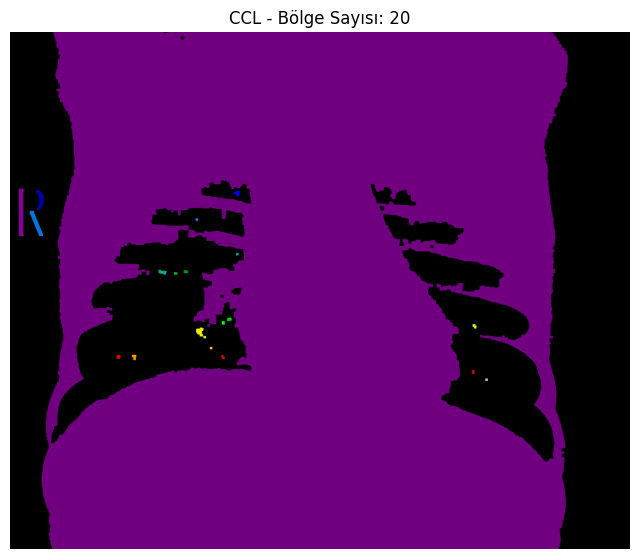


Bölge Sayısı: 20
Image 1 Region Data:
Label: 1, Centroid: (519.3981721501794, 605.8457228380132), Area: 910031.0, Eccentricity: 0.4767411800688717, Solidity: 0.8259546030878758, Mean Intensity: 183.74716575589184, Orientation: -0.10464279201749667, 

Label: 2, Centroid: (366.5, 22.05720823798627), Area: 874.0, Eccentricity: 0.995600437652938, Solidity: 0.9104166666666667, Mean Intensity: 254.81693363844394, Orientation: 0.0, 

Label: 3, Centroid: (340.93956043956047, 61.1510989010989), Area: 364.0, Eccentricity: 0.9477260840133593, Solidity: 0.7338709677419355, Mean Intensity: 254.42582417582418, Orientation: 0.04333141795918895, 

Label: 4, Centroid: (327.8878504672897, 459.7570093457944), Area: 107.0, Eccentricity: 0.5572731886566645, Solidity: 0.8770491803278688, Mean Intensity: 127.18691588785046, Orientation: -1.3659525817353915, 

Label: 5, Centroid: (388.8733905579399, 52.8412017167382), Area: 466.0, Eccentricity: 0.9879195639993315, Solidity: 0.8859315589353612, Mean Intensity

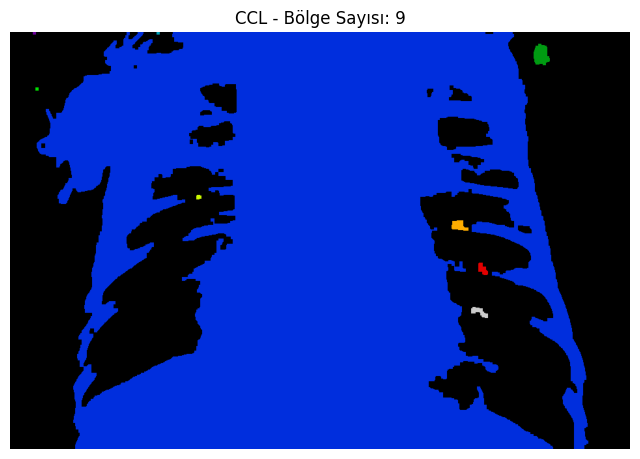


Bölge Sayısı: 9
Image 2 Region Data:
Label: 1, Centroid: (1.5, 37.0), Area: 20.0, Eccentricity: 0.6123724356957945, Solidity: 1.0, Mean Intensity: 252.25, Orientation: 1.5707963267948966, 

Label: 2, Centroid: (314.7286737022804, 456.63971508272465), Area: 358841.0, Eccentricity: 0.23517891601345475, Solidity: 0.7346374319289195, Mean Intensity: 162.35920923194396, Orientation: 0.7152512876844658, 

Label: 3, Centroid: (1.5, 227.0), Area: 20.0, Eccentricity: 0.6123724356957945, Solidity: 1.0, Mean Intensity: 125.2, Orientation: 1.5707963267948966, 

Label: 4, Centroid: (34.785483870967745, 815.0596774193548), Area: 620.0, Eccentricity: 0.6897157089266288, Solidity: 0.9117647058823529, Mean Intensity: 121.29354838709678, Orientation: 0.10442748590469984, 

Label: 5, Centroid: (87.0, 41.0), Area: 25.0, Eccentricity: 0.0, Solidity: 1.0, Mean Intensity: 162.84, Orientation: -0.7853981633974483, 

Label: 6, Centroid: (253.0, 289.3), Area: 50.0, Eccentricity: 0.560870057887585, Solidity: 0.

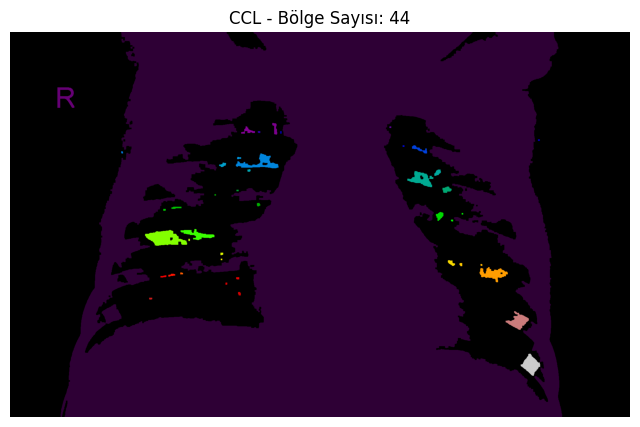


Bölge Sayısı: 44
Image 3 Region Data:
Label: 1, Centroid: (630.8941666240382, 1003.5602001330008), Area: 1329316.0, Eccentricity: 0.4520830601781975, Solidity: 0.7252698928503424, Mean Intensity: 173.54370443145197, Orientation: -0.984017967671023, 

Label: 2, Centroid: (207.30006013229104, 174.59290438965724), Area: 1663.0, Eccentricity: 0.3802202387520426, Solidity: 0.4918663117420881, Mean Intensity: 251.62056524353576, Orientation: 0.19261672859666237, 

Label: 3, Centroid: (309.32738095238096, 843.6607142857143), Area: 336.0, Eccentricity: 0.9643589045892585, Solidity: 0.7466666666666667, Mean Intensity: 122.83333333333333, Orientation: 0.16662707858956938, 

Label: 4, Centroid: (316.6592592592593, 756.9185185185186), Area: 405.0, Eccentricity: 0.8632000369759573, Solidity: 0.6211656441717791, Mean Intensity: 124.20246913580247, Orientation: 1.510174626800676, 

Label: 5, Centroid: (305.0, 1210.5), Area: 30.0, Eccentricity: 0.560611910581388, Solidity: 1.0, Mean Intensity: 120.9,

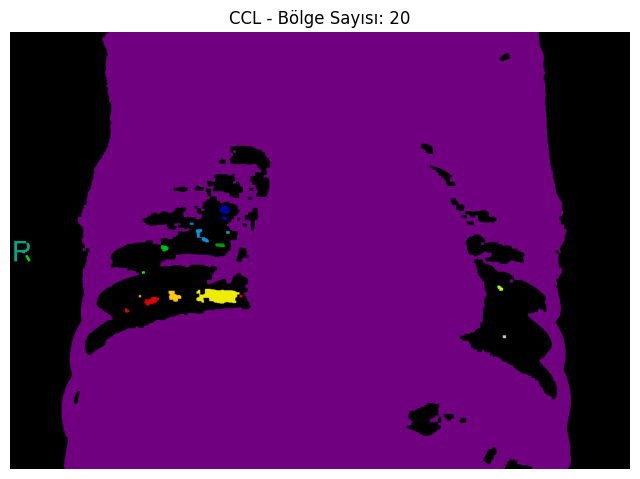


Bölge Sayısı: 20
Image 4 Region Data:
Label: 1, Centroid: (468.19631259957225, 661.7694552576576), Area: 821012.0, Eccentricity: 0.31458634816429387, Solidity: 0.8676269955921811, Mean Intensity: 151.43100588054742, Orientation: -0.963284450257874, 

Label: 2, Centroid: (254.0, 474.0), Area: 25.0, Eccentricity: 0.0, Solidity: 1.0, Mean Intensity: 97.48, Orientation: -0.7853981633974483, 

Label: 3, Centroid: (376.3457627118644, 453.1423728813559), Area: 295.0, Eccentricity: 0.5419732913872146, Solidity: 0.9516129032258065, Mean Intensity: 110.2542372881356, Orientation: 1.2786977775192314, 

Label: 4, Centroid: (394.72727272727275, 453.27272727272725), Area: 55.0, Eccentricity: 0.7356754543539847, Solidity: 0.9482758620689655, Mean Intensity: 102.14545454545454, Orientation: 1.2172328153568115, 

Label: 5, Centroid: (406.0, 383.5), Area: 40.0, Eccentricity: 0.7867957924694432, Solidity: 1.0, Mean Intensity: 100.725, Orientation: 1.5707963267948966, 

Label: 6, Centroid: (431.675182481

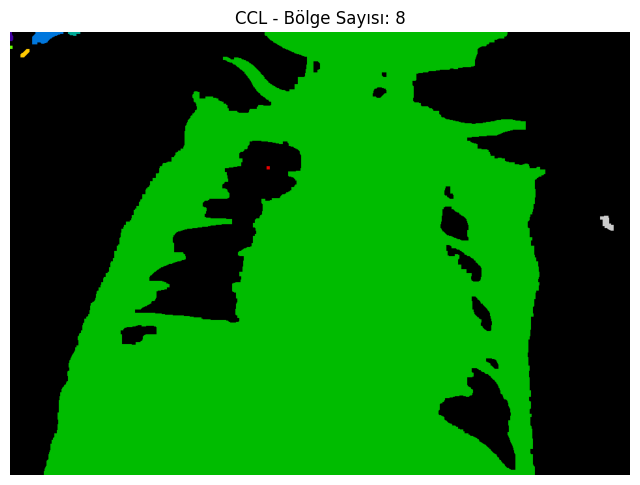


Bölge Sayısı: 8
Image 5 Region Data:
Label: 1, Centroid: (7.051724137931035, 1.6551724137931034), Area: 58.0, Eccentricity: 0.9425312568393908, Solidity: 0.9354838709677419, Mean Intensity: 131.3448275862069, Orientation: 0.07465062558837111, 

Label: 2, Centroid: (7.262032085561497, 51.7825311942959), Area: 561.0, Eccentricity: 0.9303850437575971, Solidity: 0.8738317757009346, Mean Intensity: 149.28698752228163, Orientation: -1.3178617619955226, 

Label: 3, Centroid: (1.8674698795180722, 97.6144578313253), Area: 83.0, Eccentricity: 0.950997831932834, Solidity: 0.8736842105263158, Mean Intensity: 159.57831325301206, Orientation: -1.5476713167929026, 

Label: 4, Centroid: (391.70941054221487, 474.793119112378), Area: 352222.0, Eccentricity: 0.6217953156902213, Solidity: 0.813705060735292, Mean Intensity: 140.4345810312814, Orientation: -0.8126342181683318, 

Label: 5, Centroid: (23.0, 1.5), Area: 20.0, Eccentricity: 0.6123724356957945, Solidity: 1.0, Mean Intensity: 160.15, Orientation

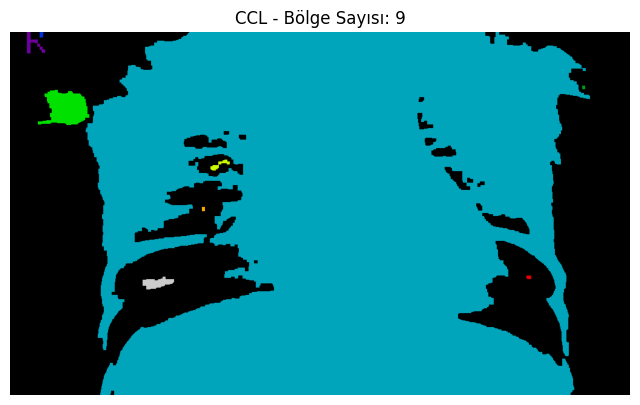


Bölge Sayısı: 9
Image 6 Region Data:
Label: 1, Centroid: (19.975675675675674, 36.75405405405405), Area: 370.0, Eccentricity: 0.7680435125735343, Solidity: 0.505464480874317, Mean Intensity: 252.4945945945946, Orientation: 0.6800209359897801, 

Label: 2, Centroid: (4.859375, 51.421875), Area: 64.0, Eccentricity: 0.8436826410636641, Solidity: 0.9846153846153847, Mean Intensity: 246.875, Orientation: -0.05276332545454703, 

Label: 3, Centroid: (293.47515182160384, 542.8218005097324), Area: 391578.0, Eccentricity: 0.5250590108198769, Solidity: 0.8238648078873286, Mean Intensity: 149.52295072756897, Orientation: -1.5362220346624396, 

Label: 4, Centroid: (92.5, 947.0), Area: 30.0, Eccentricity: 0.560611910581388, Solidity: 1.0, Mean Intensity: 98.0, Orientation: 0.0, 

Label: 5, Centroid: (126.61183395291202, 92.58333333333333), Area: 3228.0, Eccentricity: 0.600241811832389, Solidity: 0.7919528949950932, Mean Intensity: 106.49225526641884, Orientation: 1.4385283579062607, 

Label: 6, Centr

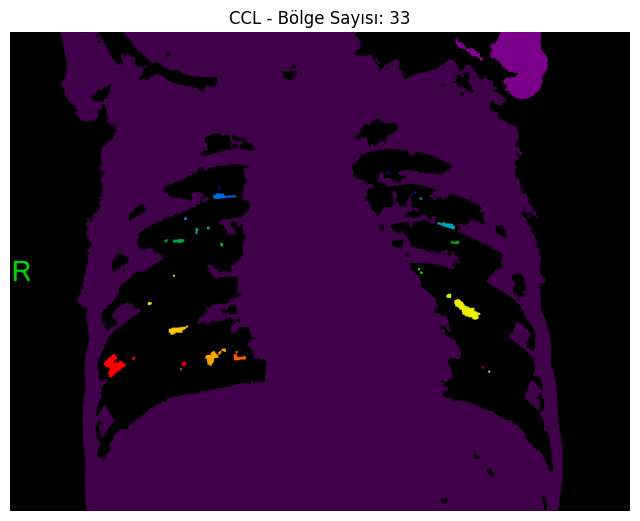


Bölge Sayısı: 33
Image 7 Region Data:
Label: 1, Centroid: (635.7522176152661, 760.7248027307428), Area: 1032979.0, Eccentricity: 0.5963628281157252, Solidity: 0.7280093367509827, Mean Intensity: 159.6427991275718, Orientation: 0.38278645316134985, 

Label: 2, Centroid: (76.57562358276644, 1297.8358843537414), Area: 17640.0, Eccentricity: 0.7162044683865437, Solidity: 0.8726193420727183, Mean Intensity: 129.8640022675737, Orientation: 0.2529215704048735, 

Label: 3, Centroid: (48.0090395480226, 1164.7920903954803), Area: 885.0, Eccentricity: 0.9863877607849414, Solidity: 0.6272147413182141, Mean Intensity: 106.21920903954802, Orientation: 0.9974500564031862, 

Label: 4, Centroid: (89.0, 342.0), Area: 25.0, Eccentricity: 0.0, Solidity: 1.0, Mean Intensity: 105.92, Orientation: -0.7853981633974483, 

Label: 5, Centroid: (359.0731707317073, 960.560975609756), Area: 41.0, Eccentricity: 0.5322721205690045, Solidity: 1.0, Mean Intensity: 107.82926829268293, Orientation: -0.17277779029085608,

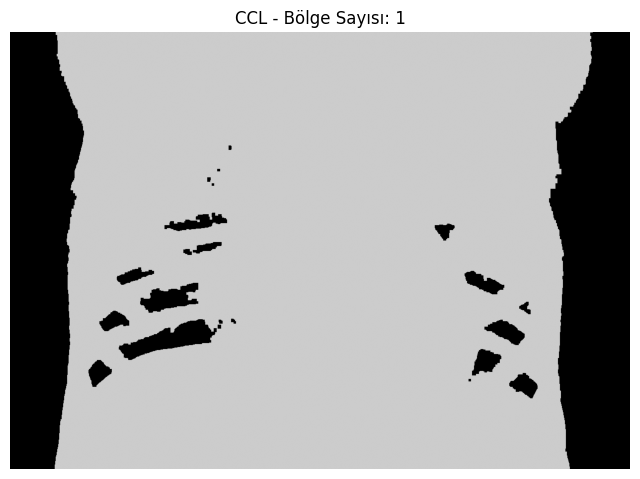


Bölge Sayısı: 1
Image 8 Region Data:
Label: 1, Centroid: (433.953588823048, 619.6929832172194), Area: 852898.0, Eccentricity: 0.43901821608207764, Solidity: 0.9148144731733164, Mean Intensity: 173.29018593079127, Orientation: -1.457191178318912, 



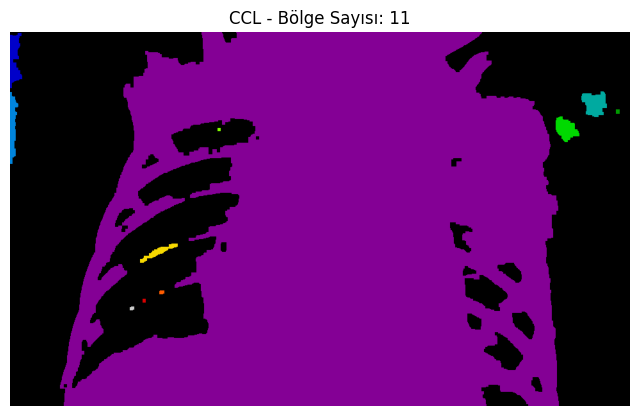


Bölge Sayısı: 11
Image 9 Region Data:
Label: 1, Centroid: (306.9502076413193, 511.15662003271206), Area: 336879.0, Eccentricity: 0.456153225161977, Solidity: 0.824009549224737, Mean Intensity: 154.87171951947138, Orientation: -1.3741797494316668, 

Label: 2, Centroid: (42.87366375121477, 6.643343051506317), Area: 1029.0, Eccentricity: 0.9804301337321717, Solidity: 0.7023890784982935, Mean Intensity: 132.1865889212828, Orientation: -0.015688627718482964, 

Label: 3, Centroid: (148.2839779005525, 3.870718232044199), Area: 905.0, Eccentricity: 0.9957560507922149, Solidity: 0.7973568281938326, Mean Intensity: 134.11160220994475, Orientation: -0.013275065455421458, 

Label: 4, Centroid: (112.83856502242152, 912.4179372197309), Area: 1115.0, Eccentricity: 0.3646117908706064, Solidity: 0.8421450151057401, Mean Intensity: 121.74349775784754, Orientation: 0.7298056697830222, 

Label: 5, Centroid: (125.0, 948.5), Area: 42.0, Eccentricity: 0.5204164998665333, Solidity: 1.0, Mean Intensity: 117.7

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from skimage.filters import threshold_otsu
from skimage.measure import regionprops

def apply_morphological_operations(image_path):
    original_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Otsu Thresholding
    otsu_thresh = threshold_otsu(original_image)
    binary_otsu = original_image > otsu_thresh

    # Morfolojik Operatörler
    kernel = np.ones((5, 5), np.uint8)
    morph_open = cv2.morphologyEx(binary_otsu.astype(np.uint8), cv2.MORPH_OPEN, kernel)
    morph_close = cv2.morphologyEx(morph_open, cv2.MORPH_CLOSE, kernel)

    return original_image, binary_otsu, morph_open, morph_close

def connected_components_analysis(morph_close, original_image):
    # Bağlantı Bileşen Analizi (CCL)
    num_labels, labels = cv2.connectedComponents(morph_close)

    # Görselleştirme
    plt.figure(figsize=(8, 8))
    plt.imshow(labels, cmap='nipy_spectral')
    plt.title(f'CCL - Bölge Sayısı: {num_labels-1}')
    plt.axis('off')
    plt.show()

    print(f"\nBölge Sayısı: {num_labels-1}")

    # RegionProperties kullanarak her bir bölgeyi analiz et
    regions = regionprops(labels, intensity_image=original_image)

    region_data = []
    for region in regions:
        region_data.append({
            'label': region.label,
            'centroid': region.centroid,
            'area': region.area,
            'eccentricity': region.eccentricity,
            'solidity': region.solidity,
            'mean_intensity': region.mean_intensity,
            'orientation': region.orientation
        })

    return num_labels, labels, region_data

for idx, image_path in enumerate(sampled_images[:9]):
    original_image, binary_otsu, morph_open, morph_close = apply_morphological_operations(image_path)

    # Bağlantı Bileşen Analizi ve RegionProperties
    num_labels, labels, region_data = connected_components_analysis(morph_close, original_image)

    # Her bir bölge verisini yazdır
    print(f"Image {idx+1} Region Data:")
    for region in region_data:
        print(f"Label: {region['label']}, Centroid: {region['centroid']}, Area: {region['area']}, "
              f"Eccentricity: {region['eccentricity']}, Solidity: {region['solidity']}, "
              f"Mean Intensity: {region['mean_intensity']}, Orientation: {region['orientation']}, \n")

Görüntü işleme ve bilgisayarlı görü alanlarında, özellikle nesne tanıma, segmentasyon ve sınıflandırma gibi görevlerde, her bir bileşeni ayrı olarak ele almak ve bunların özelliklerini incelemek büyük önem taşır. Bağlantı bileşen analizi (CCL) sayesinde, görüntüde birbirinden bağımsız nesneler veya bölgeler etiketlenerek tespit edilir ve her bir bileşenin alanı, konumu, yoğunluğu gibi öznitelikler çıkarılır. Bu öznitelikler, nesnelerin şekilsel özelliklerini anlamak, farklı nesneleri sınıflandırmak veya belirli kriterlere göre filtreleme yapmak için kullanılır. Örneğin, biyomedikal görüntülerde hücreleri saymak, üretim hatlarında nesne tespiti yapmak veya trafik kameralarında araçları belirlemek gibi birçok alanda bu tür analizler kritik rol oynar. Dolayısıyla, bu süreç görüntüdeki bilgi miktarını artırarak, karar verme mekanizmalarına girdi sağlayan bir veri analizi sürecine dönüşür.

Resim 1'de yapılan Bağlantı Bileşen Analizi (CCL) sonucunda 20 farklı bölge tespit edilmiştir. Bu bölgeler arasında en büyük alanı kaplayan Label 1 yaklaşık 910031 piksel büyüklüğündedir ve görüntünün büyük bir kısmını oluşturur. Eksantriklik değeri 0.47 olduğu için nispeten kompakt bir yapıya sahiptir. Ortalama yoğunluğu 183.74 olup, diğer küçük bölgelere kıyasla daha parlak bir yapı göstermektedir. Diğer bölgeler oldukça küçük olup, alanları 25 ile 874 piksel arasında değişmektedir. Eksantriklikleri 0’a yakın olan bölgeler tam yuvarlak bir forma sahiptir, yüksek eksantriklik değerlerine sahip bölgeler ise daha eliptik bir yapı sergilemektedir. Katılık (solidity) değerleri 0.7 ile 1.0 arasında değişmekte, bu da bazı bölgelerin oldukça yoğun ve düzgün, bazılarının ise daha girintili çıkıntılı olduğunu göstermektedir.

Görüntüde bazı bölgeler oldukça parlak olup (örneğin Label 2 ve 3’ün ortalama yoğunluğu yaklaşık 254, yani neredeyse beyazdır), bazı bölgeler ise daha koyu tonlara sahiptir (Label 6, 7, 10, 15 gibi bölgelerin yoğunluk ortalamaları 125-130 civarındadır). Genel yapı itibarıyla simetrik formlar içerdiği için görüntü bir röntgen veya medikal görüntü olabilir. Bununla birlikte, yüksek eksantrikliğe sahip küçük bileşenler segmentasyon hatası veya gürültü kaynaklı olabilir. Segmentasyon kalitesini artırmak için morfolojik işlemlerde kernel boyutu artırılarak küçük ve gereksiz bileşenler temizlenebilir. Ayrıca, çok küçük bileşenleri filtrelemek amacıyla bir alan eşiği belirlenebilir (örneğin, 50 pikselden küçük olanlar hariç tutulabilir). Alternatif olarak, watershed gibi farklı segmentasyon yöntemleri de denenerek daha iyi bileşen ayrımı sağlanabilir.

Filtered Regions (Top by Area & Centroids Check): [1, 2]


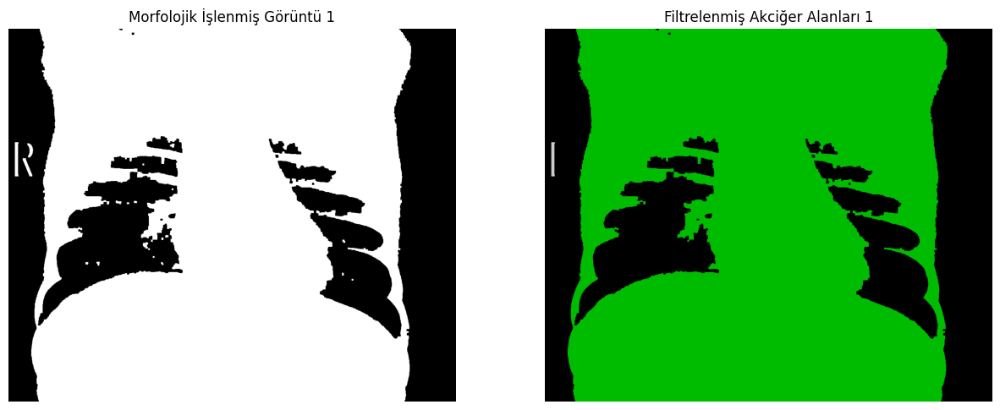

Filtered Regions (Top by Area & Centroids Check): [2, 4]


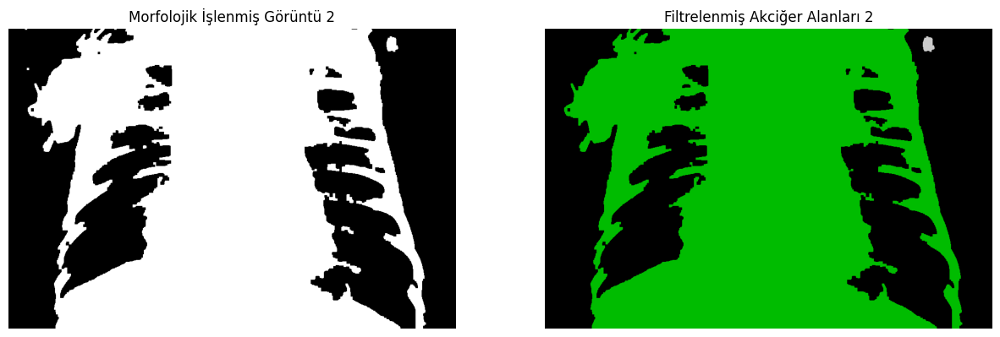

Filtered Regions (Top by Area & Centroids Check): [1, 28]


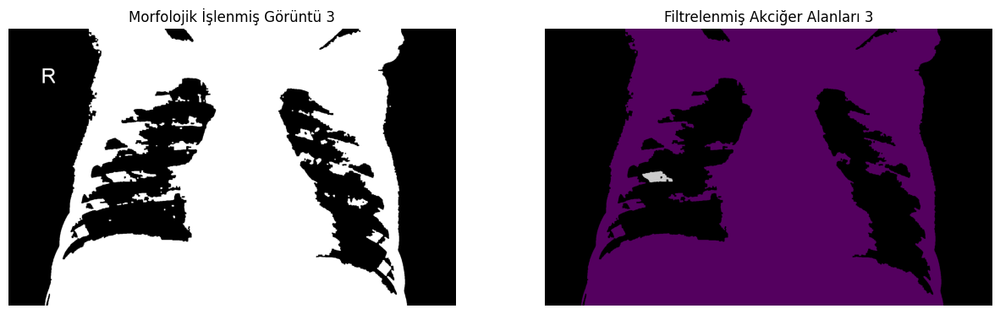

Filtered Regions (Top by Area & Centroids Check): [1, 14]


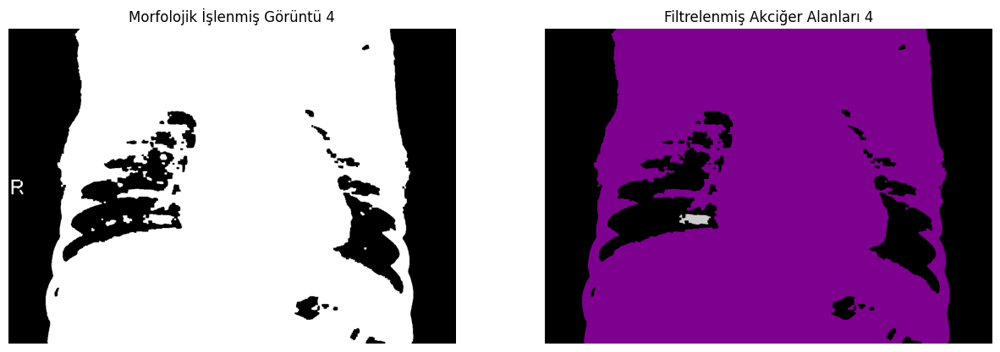

Filtered Regions (Top by Area & Centroids Check): [4, 2]


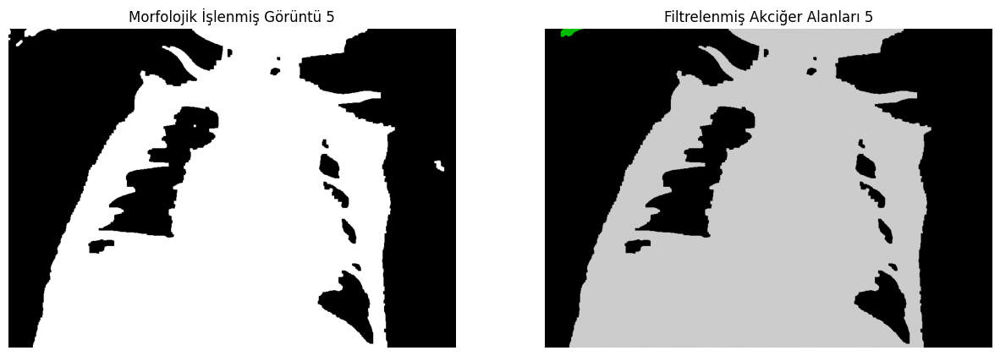

Filtered Regions (Top by Area & Centroids Check): [3, 5]


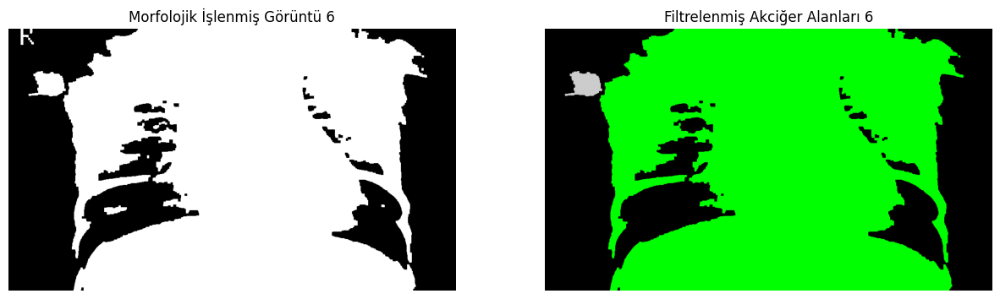

Filtered Regions (Top by Area & Centroids Check): [1, 2]


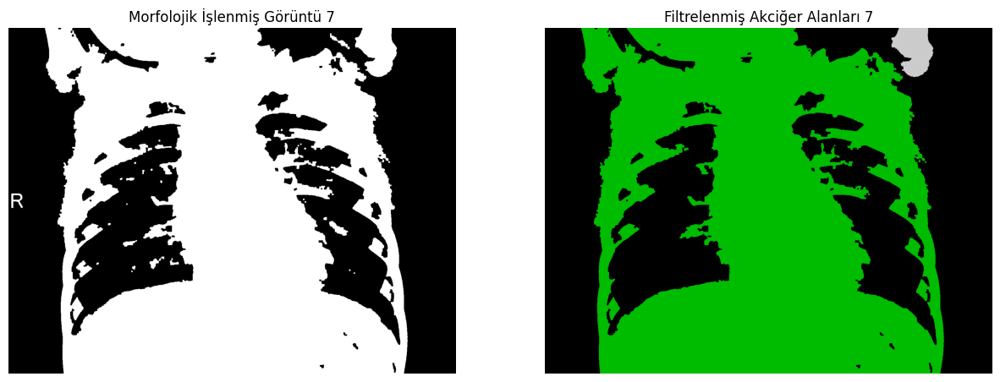

Filtered Regions (Top by Area & Centroids Check): [1]


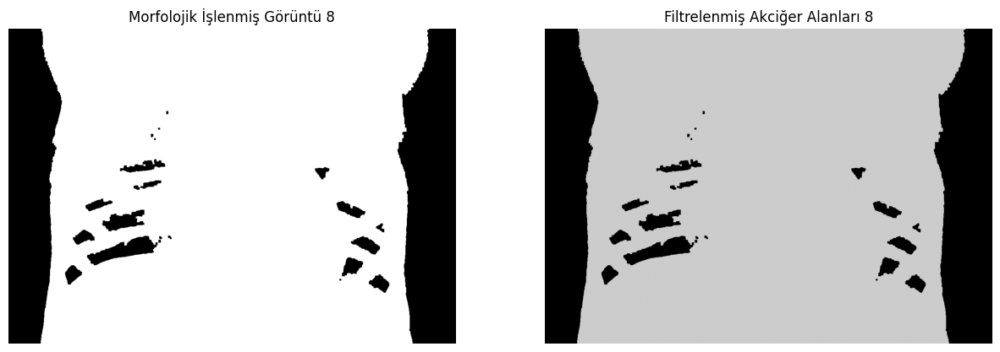

Filtered Regions (Top by Area & Centroids Check): [1, 4]


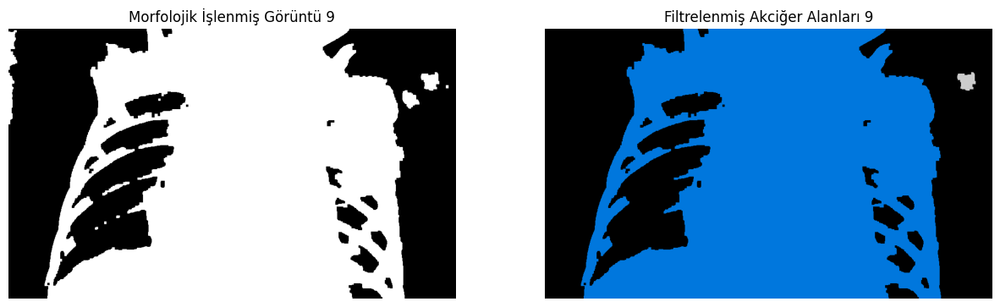

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from skimage.measure import regionprops

# Filtreleme işlemi için kriterler
def filter_regions_by_area_and_centroid(region_data):
    # Alanına göre sıralama
    region_data.sort(key=lambda x: x['area'], reverse=True)

    # Maksimum alana sahip iki bölgeyi seç
    filtered_regions = region_data[:2]

    # İlk iki bölgenin centroidlerinin ortada olup olmadığını kontrol et
    centroids = [region['centroid'] for region in filtered_regions]
    centroids_x = [centroid[0] for centroid in centroids]
    centroids_y = [centroid[1] for centroid in centroids]

    # Eğer centroidler ortada değilse, 3. bölgeyi dene
    if not (min(centroids_x) < np.mean(centroids_x) < max(centroids_x) and
            min(centroids_y) < np.mean(centroids_y) < max(centroids_y)):
        filtered_regions = region_data[:3]  # 3. bölgeyi ekleyelim

    print(f"Filtered Regions (Top by Area & Centroids Check): {[region['label'] for region in filtered_regions]}")

    return filtered_regions

def extract_region_properties(labels, original_image):
    # RegionProperties kullanarak her bir bölgeyi analiz et
    regions = regionprops(labels, intensity_image=original_image)

    region_data = []
    for region in regions:
        region_data.append({
            'label': region.label,
            'centroid': region.centroid,
            'area': region.area,
            'eccentricity': region.eccentricity,
            'solidity': region.solidity,
            'mean_intensity': region.mean_intensity,
            'orientation': region.orientation
        })

    return region_data

def connected_components_analysis(morph_close):
    # Bağlantı Bileşen Analizi (CCL)
    num_labels, labels = cv2.connectedComponents(morph_close)

    return num_labels, labels

# Görselleştirme ve işlemi birleştirelim
for idx, image_path in enumerate(sampled_images[:9]):
    original_image, binary_otsu, morph_open, morph_close = apply_morphological_operations(image_path)
    num_labels, labels = connected_components_analysis(morph_close)
    region_data = extract_region_properties(labels, original_image)

    # Akciğer alanlarını en iyi ifade eden özniteliklere göre filtreleme yap
    filtered_regions = filter_regions_by_area_and_centroid(region_data)

    # Seçilen bölgeleri işaretleyip görselleştirelim
    labeled_image = np.zeros_like(labels)
    for region in filtered_regions:
        labeled_image[labels == region['label']] = region['label']

    # Giriş ve çıkış görüntülerini yan yana görselleştirelim
    plt.figure(figsize=(15, 8))

    # Orijinal morfolojik işlemi yapılmış görüntü
    plt.subplot(1, 2, 1)
    plt.imshow(morph_close, cmap='gray')
    plt.title(f'Morfolojik İşlenmiş Görüntü {idx+1}')
    plt.axis('off')

    # Filtrelenmiş görüntü
    plt.subplot(1, 2, 2)
    plt.imshow(labeled_image, cmap='nipy_spectral')
    plt.title(f'Filtrelenmiş Akciğer Alanları {idx+1}')
    plt.axis('off')

    plt.show()


Filtreleme, görüntü işleme süreçlerinde belirli nesneleri veya bölgeleri ayırt etmek ve istenmeyen parçaları elemine etmek için kullanılır. Akciğer görüntüleri üzerinde yapılan filtreleme işlemi, akciğer dokusunu çevreleyen diğer anatomik yapılar veya gürültüden ayırarak net bir segmentasyon sağlamak amacıyla gerçekleştirilir. Bu sayede, analiz edilecek alanın daha doğru belirlenmesi ve modelin yalnızca ilgili bölgeler üzerinde çalışması sağlanır. Özellikle tıbbi görüntü analizinde, akciğer gibi belirli organları hedefleyerek doğru teşhis ve değerlendirme yapmak için filtreleme kritik bir adımdır.

Filtreleme sonucunda elde edilen akciğer alanları genellikle başarılı bir şekilde belirlenmiş, çoğu görselde iki büyük bölge seçilmiş. Görsel 1, 2, 7 ve 9 gibi örneklerde akciğer lobları net bir şekilde ayrılmışken, Görsel 8’de yalnızca bir bölgenin seçilmesi segmentasyon sürecinde bir eksiklik olduğunu gösteriyor. Görsel 3, 4 ve 6’da, seçilen ikinci bölgenin gerçekten akciğer olup olmadığı sorgulanabilir. Görsel 5 ve 6’da ise bazı dış kısımlar da filtreleme sonucu dahil olmuş olabilir.

Filtered Regions (Top by Area & Centroids Check): [3, 252]


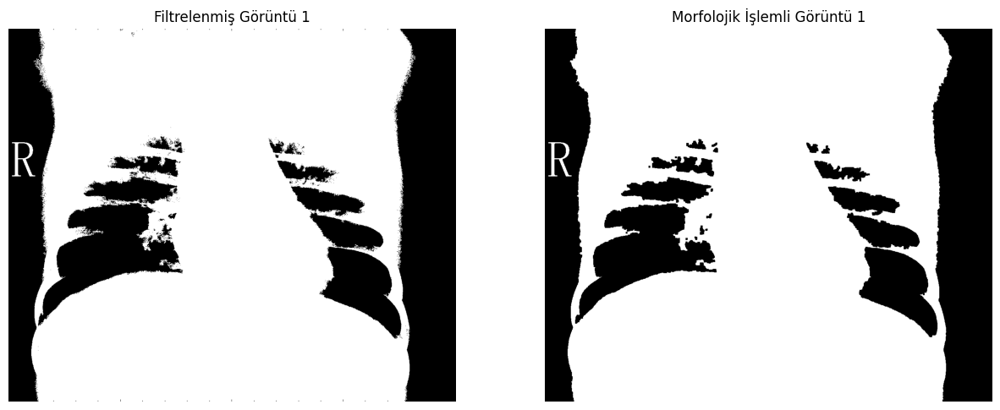

Filtered Regions (Top by Area & Centroids Check): [3, 10]


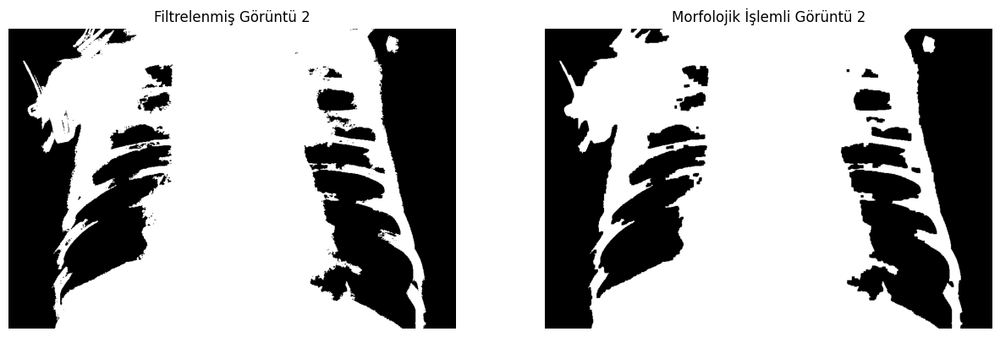

Filtered Regions (Top by Area & Centroids Check): [4, 552]


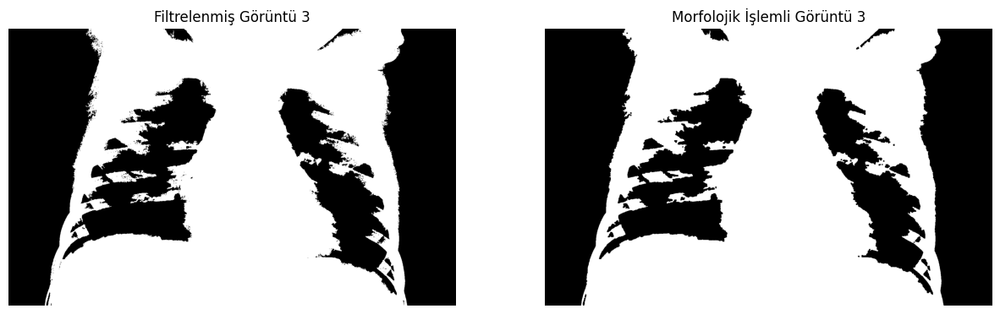

Filtered Regions (Top by Area & Centroids Check): [1, 295]


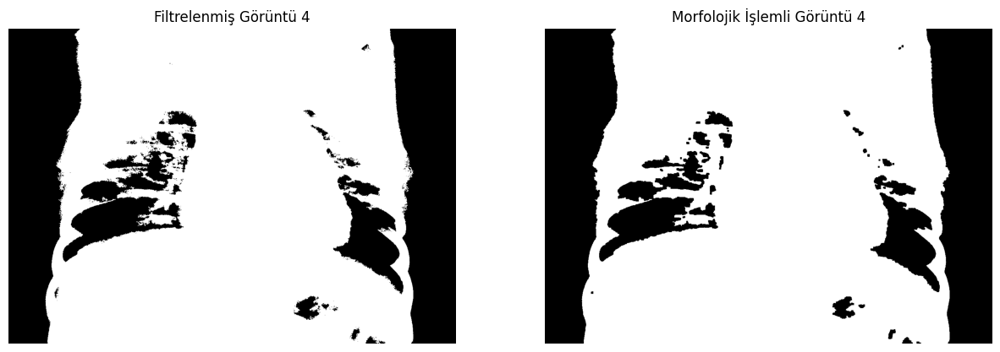

Filtered Regions (Top by Area & Centroids Check): [3, 2]


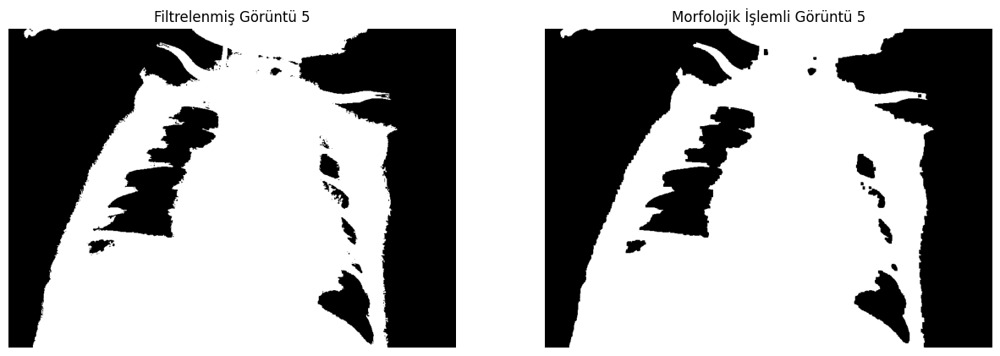

Filtered Regions (Top by Area & Centroids Check): [3, 292]


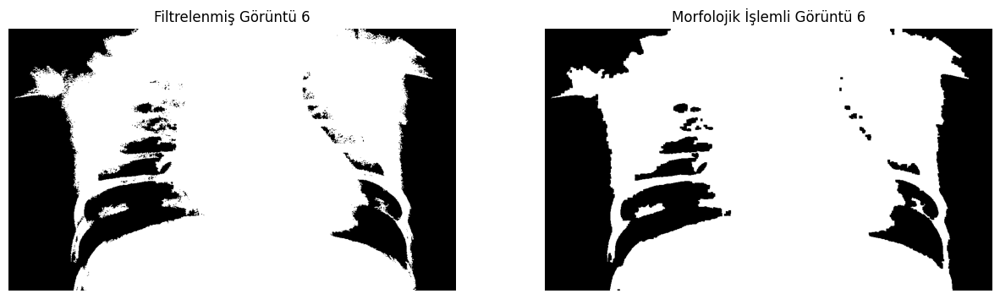

Filtered Regions (Top by Area & Centroids Check): [1, 907]


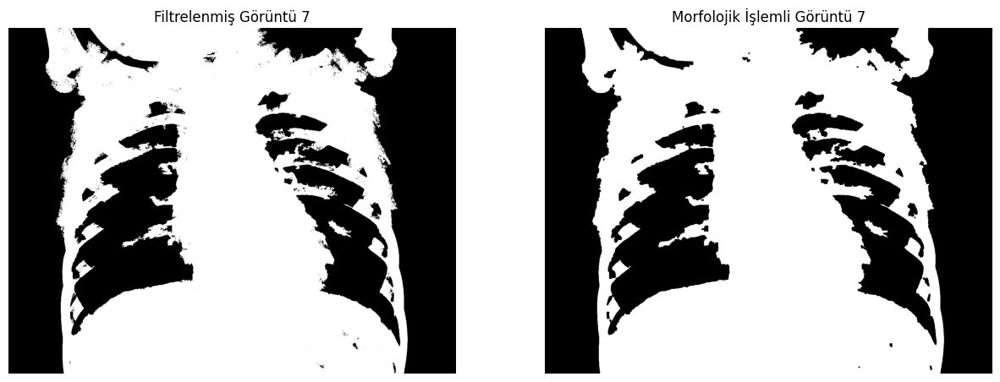

Filtered Regions (Top by Area & Centroids Check): [1, 83]


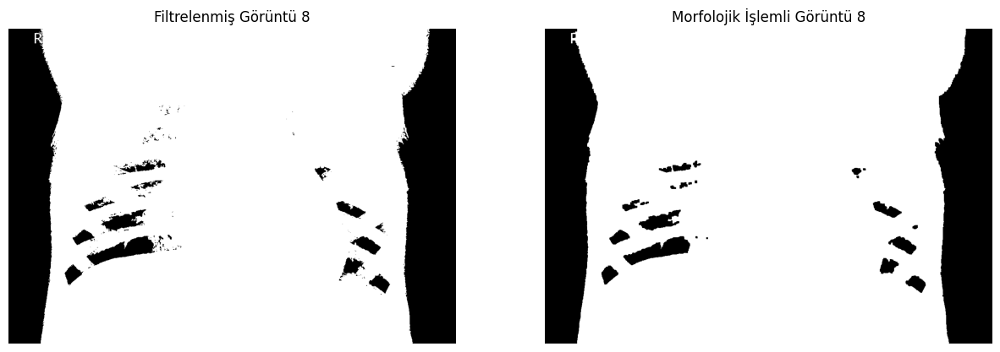

Filtered Regions (Top by Area & Centroids Check): [2, 50]


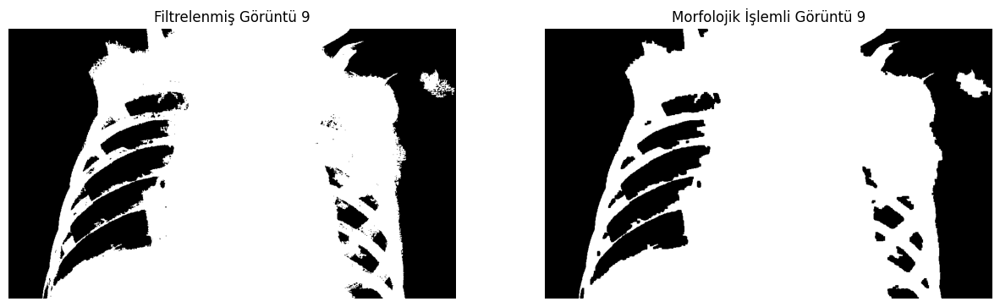

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

def apply_morphological_operations(filtered_image):
    # Yapısal eleman seçimi (açma ve kapama için)
    kernel = np.ones((5, 5), np.uint8)  # 5x5 boyutunda kare bir yapı elemanı

    # Açma (Opening) işlemi
    morph_open = cv2.morphologyEx(filtered_image, cv2.MORPH_OPEN, kernel)

    # Kapama (Closing) işlemi
    morph_close = cv2.morphologyEx(filtered_image, cv2.MORPH_CLOSE, kernel)

    return morph_open, morph_close


for idx, image_path in enumerate(sampled_images[:9]):
    original_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)


    _, binary_otsu = cv2.threshold(original_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)


    filtered_image = np.zeros_like(binary_otsu)
    num_labels, labels = connected_components_analysis(binary_otsu)
    region_data = extract_region_properties(labels, original_image)
    filtered_regions = filter_regions_by_area_and_centroid(region_data)


    for region in filtered_regions:
        filtered_image[labels == region['label']] = 255

    # Morfolojik işlemler (açma ve kapama)
    morph_open_filtered, morph_close_filtered = apply_morphological_operations(filtered_image)
    plt.figure(figsize=(15, 8))

    # Orijinal morfolojik işlemli görüntü
    plt.subplot(1, 2, 1)
    plt.imshow(filtered_image, cmap='gray')
    plt.title(f'Filtrelenmiş Görüntü {idx+1}')
    plt.axis('off')

    # Morfolojik işlem yapılmış (kapama) görüntü
    plt.subplot(1, 2, 2)
    plt.imshow(morph_close_filtered, cmap='gray')
    plt.title(f'Morfolojik İşlemli Görüntü {idx+1}')
    plt.axis('off')

    plt.show()


Filtrelenmiş akciğer görüntülerine uygun morfolojik işlemler uygulandı. Bu süreçte, açma (opening) ve kapama (closing) işlemleri için kare şeklinde 5x5 boyutunda bir yapı elemanı (structural element) kullanıldı. Açma işlemi, küçük gürültüleri ve istenmeyen küçük nesneleri temizlemek için kullanılırken, kapama işlemi akciğer sınırlarını daha belirgin hale getirmek ve boşlukları doldurmak için uygulandı.


Morfolojik işlemler sonrası elde edilen görüntülerde, akciğer alanlarının sınırları daha düzgün ve net bir şekilde ortaya çıktı. Önceki filtreleme aşamasında bazı küçük parçalar hala mevcutken, açma işlemi bu parçaları temizlemeye yardımcı oldu. Kapama işlemi ise akciğerlerin içindeki kesintili bölgeleri birleştirerek daha bütüncül bir yapı oluşturdu.

Görselleri incelediğimizde, bazı görüntülerde hala küçük kayıpların olabileceği ancak genel olarak akciğer alanlarının belirgin hale geldiği gözlemlendi. Bu süreç, özellikle akciğer bölgesini vurgulamak ve tıbbi analizlerde segmentasyon doğruluğunu artırmak için önemli bir adımdır.

Filtered Regions (Top by Area & Centroids Check): [3, 252]


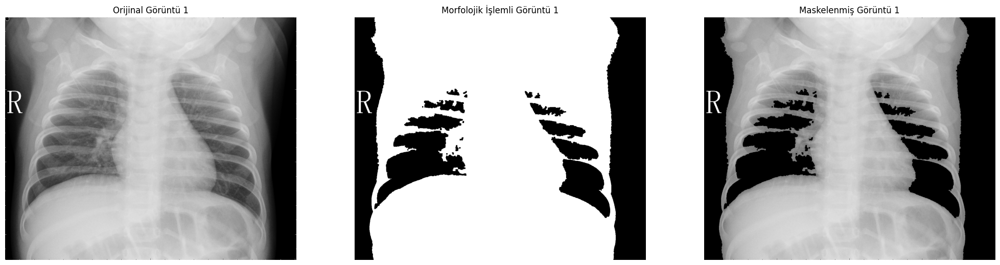

Filtered Regions (Top by Area & Centroids Check): [3, 10]


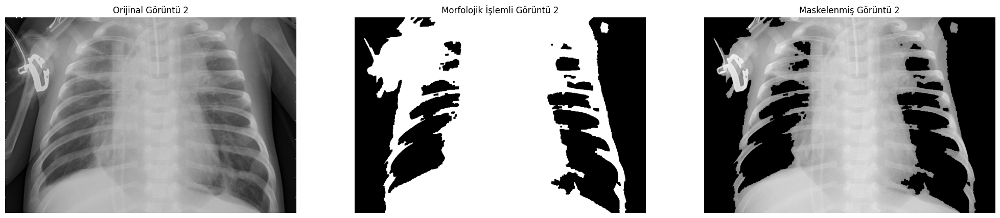

Filtered Regions (Top by Area & Centroids Check): [4, 552]


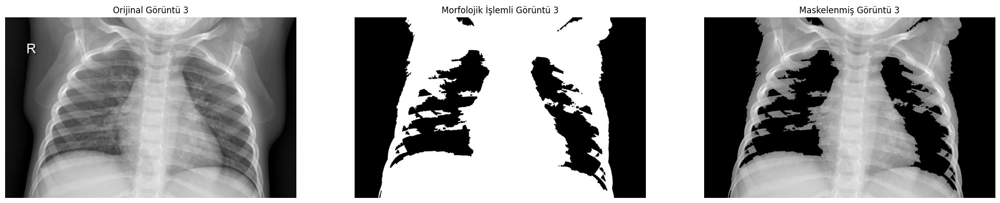

Filtered Regions (Top by Area & Centroids Check): [1, 295]


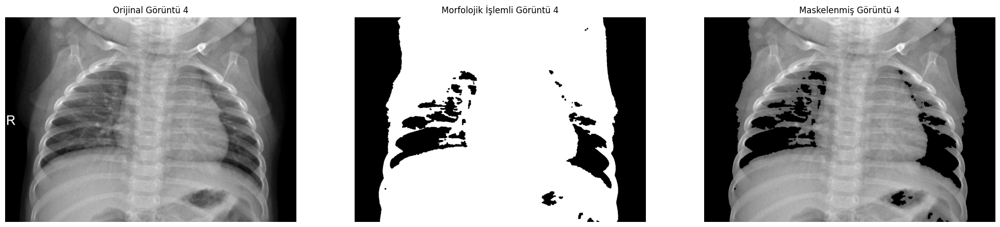

Filtered Regions (Top by Area & Centroids Check): [3, 2]


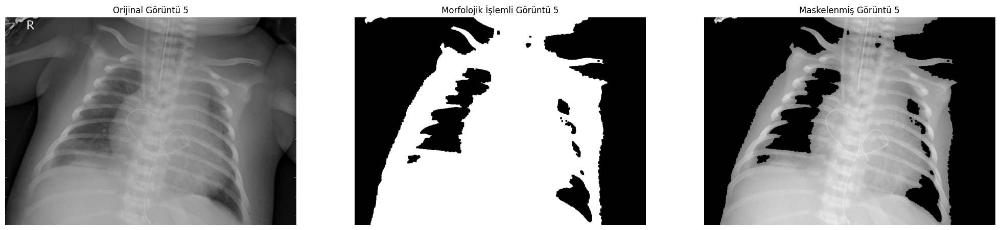

Filtered Regions (Top by Area & Centroids Check): [3, 292]


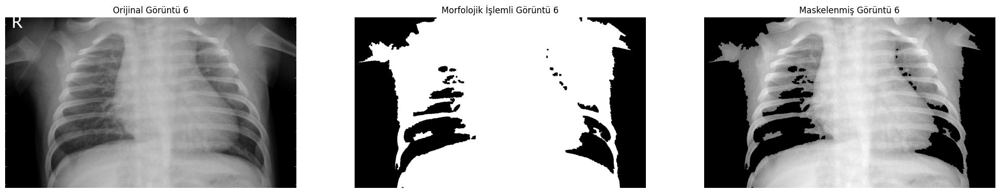

Filtered Regions (Top by Area & Centroids Check): [1, 907]


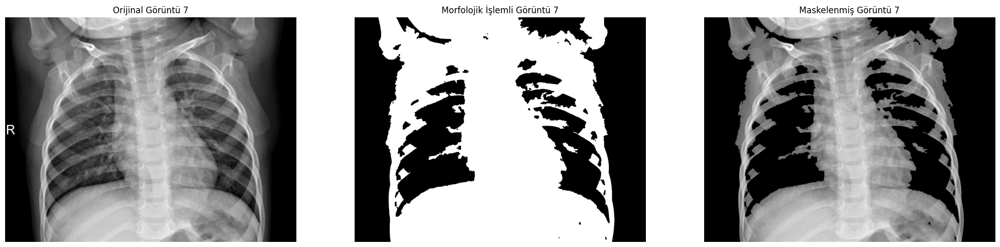

Filtered Regions (Top by Area & Centroids Check): [1, 83]


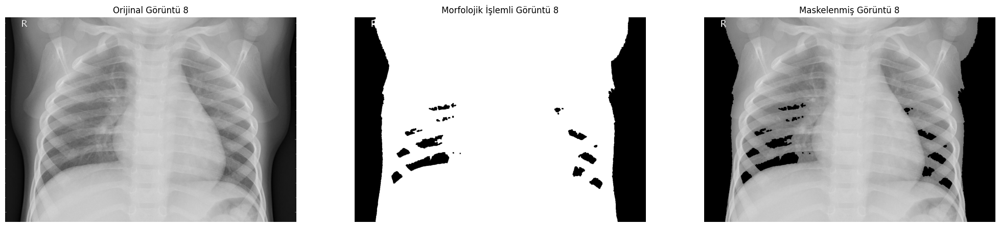

Filtered Regions (Top by Area & Centroids Check): [2, 50]


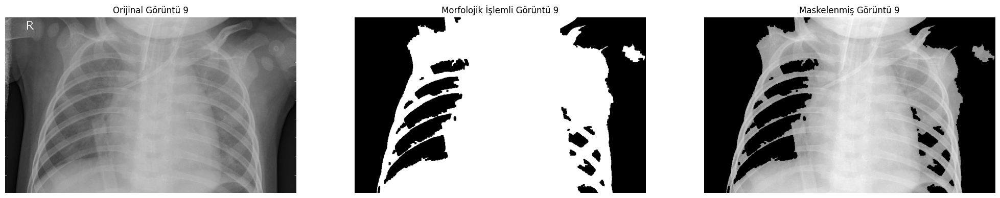

In [ ]:
def apply_morphological_operations(filtered_image):

    kernel = np.ones((5, 5), np.uint8)

    # Açma (Opening) işlemi
    morph_open = cv2.morphologyEx(filtered_image, cv2.MORPH_OPEN, kernel)

    # Kapama (Closing) işlemi
    morph_close = cv2.morphologyEx(filtered_image, cv2.MORPH_CLOSE, kernel)

    return morph_open, morph_close

for idx, image_path in enumerate(sampled_images[:9]):
    original_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)


    _, binary_otsu = cv2.threshold(original_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)


    filtered_image = np.zeros_like(binary_otsu)
    num_labels, labels = connected_components_analysis(binary_otsu)
    region_data = extract_region_properties(labels, original_image)
    filtered_regions = filter_regions_by_area_and_centroid(region_data)


    for region in filtered_regions:
        filtered_image[labels == region['label']] = 255

    # Morfolojik işlemler (açma ve kapama)
    morph_open_filtered, morph_close_filtered = apply_morphological_operations(filtered_image)

    # Maske ile orijinal görüntüyü çarpma (maskelenmiş görüntü)
    masked_image = cv2.bitwise_and(original_image, original_image, mask=morph_close_filtered)


    plt.figure(figsize=(25, 15))

    # Orijinal Görüntü
    plt.subplot(1, 3, 1)
    plt.imshow(original_image, cmap='gray')
    plt.title(f'Orijinal Görüntü {idx+1}')
    plt.axis('off')

    # Morfolojik işlem uygulanmış çıkış görüntüsü
    plt.subplot(1, 3, 2)
    plt.imshow(morph_close_filtered, cmap='gray')
    plt.title(f'Morfolojik İşlemli Görüntü {idx+1}')
    plt.axis('off')

    # Maskelenmiş Görüntü
    plt.subplot(1, 3, 3)
    plt.imshow(masked_image, cmap='gray')
    plt.title(f'Maskelenmiş Görüntü {idx+1}')
    plt.axis('off')

    plt.show()


Görsel 1 (Filtered Regions: [3, 252])
Morfolojik işlem sonucunda akciğer alanları iyi şekilde ayrıştırılmış ve maskelenmiş alanda belirginleşmiş. Orijinal görüntüdeki çok fazla detay kaybolmuş ve netleşmiş olan alanlar daha belirgin bir şekilde ortaya çıkmış.

Görsel 2 (Filtered Regions: [3, 10])
Bu görselde morfolojik işlem sonrası maskede daha fazla boşluk ve izlenim var. Akciğer yapılarının netliği orijinal görsele kıyasla azalmış. Maskelenmiş bölgede büyük yapıların vurgulanması sağlanmış.

Görsel 3 (Filtered Regions: [4, 552])
Morfolojik işlem sonrası akciğerler net bir şekilde ayrılmış ve maskelenmiş görüntüde bu bölgeler çok belirgin. Ancak bazı kenar bölgelerinde hafif belirsizlikler olabilir. Çalışılan alan oldukça temiz ve iyi bir şekilde maskelenmiş.

Görsel 4 (Filtered Regions: [1, 295])
Bu görselde maskelenmiş alan büyük ölçüde orijinal görsele sadık kalmış. Morfolojik işlem sonrasında oldukça temiz bir görüntü elde edilmiş. Ancak, bazı ince detaylar kaybolmuş olabilir. Maskedeki ayrıntıların çoğu, akciğerlerin temel yapısını yeterince belirgin kılıyor.

Görsel 5 (Filtered Regions: [3, 2])
Bu görüntüde büyük ölçüde boş alanlar ortaya çıkmış ve akciğer yapıları maskelenmiş görüntüde daha net. Bununla birlikte, görüntüdeki çok ince ayrıntılar kaybolmuş olabilir. Maskelenmiş bölgede daha büyük yapıların vurgulandığı gözlemleniyor.

Görsel 6 (Filtered Regions: [3, 292])
Bu görselde morfolojik işlem sonrasında akciğer yapıları net bir şekilde ayırt edilebiliyor ve maskelenmiş görüntüde belirgin hale geliyor. Morfolojik işlemler, orijinal görüntüye benzer bir yapıyı korurken gereksiz arka planları da temizlemiş.

Görsel 7 (Filtered Regions: [1, 907])
Maskelenmiş görüntüdeki büyük akciğer yapıları net bir şekilde görünürken, bazı küçük bölgelerde detay kaybı yaşanmış. Ancak genel olarak akciğer bölgesinin ayırt edilebilirliği yüksek.

Görsel 8 (Filtered Regions: [1, 83])
Bu görselde morfolojik işlem sonrası maskelenmiş görüntü oldukça belirgin hale gelmiş. Akciğerler ve çevresindeki yapılar daha iyi ayrılmış, fakat orijinal görseldeki bazı ince detaylar kaybolmuş olabilir. Maskelenmiş görüntüdeki netlik başarılı bir şekilde sağlanmış.

Görsel 9 (Filtered Regions: [2, 50])
Bu görüntüde morfolojik işlem sonrasında maskelenmiş bölge oldukça belirginleşmiş. Akciğer yapıları daha açık bir şekilde ortaya çıkmış, ancak bazı ince ayrıntılar kaybolmuş olabilir. Maskelenmiş görüntüdeki vurgulanan alanlar orijinal görseldeki önemli yapıları oldukça iyi temsil ediyor.

Her bir görüntüde morfolojik işlemlerin başarılı olduğu ve akciğer bölgelerinin çoğunlukla net bir şekilde ayrıldığı gözlemleniyor. Ancak, maskelenmiş görüntülerde bazı ince detayların kaybolduğu ve küçük bölgelerde belirsizliklerin oluştuğu görülüyor. Bu tür maskeler, akciğerlerin daha net bir şekilde izole edilmesi için yararlı olabilir, fakat görüntüdeki küçük yapılar için daha ince morfolojik işlemler gerekebilir.